**NGC0628 CO Intensity estimation and filament mass density calculations**
**Need to Verify constant, equations, and units. Also, this considers whole galaxy when maybe it shouldnt. Error propogation can also be tracked more carefully**

Papers:
1) https://arxiv.org/pdf/2410.05397   (I_CO_2_1)
2) https://arxiv.org/pdf/1301.3498    (I-CO_2_1 to Mass)

In [140]:
#imports
import numpy as np
import os
from astropy.io import fits
import matplotlib.pyplot as plt
from astropy.stats import sigma_clipped_stats
from photutils.detection import DAOStarFinder
from astropy.visualization import SqrtStretch
from astropy.visualization.mpl_normalize import ImageNormalize
from photutils.aperture import CircularAperture
import AnalysisFuncs as AF
import matplotlib.pyplot as plt
import cv2


In [141]:
#Open F700W and F300W or F200W
#Need access to F200W image
original_image_path = r"/Users/jakehoffmann/Documents/JHU_Research/FilPHANGS_Main/FilPHANGS_Data/OriginalImages/ngc0628_F770W_JWST_Emission_starsub.fits"
with fits.open(original_image_path) as hdul:
    I_F770W = hdul[0].data
    header = hdul[0].header
    I_F770W = np.nan_to_num(I_F770W)
    I_F770W = np.clip(I_F770W, 0, None)  # Set negative values to zero

In [142]:
#Ngc0628 Parameters
inclination = 9 * np.pi / 180  # Inclination in radians
sSFR = 1.74 #get specific SFR*

In [143]:
#1) Subtract .22*F300W or .13*F200W from F700W
#Skip for now - done with starlight subtraction

In [144]:
#2) Multiply by cos(inclination)
I_F770W = I_F770W * np.cos(np.radians(inclination))

In [145]:
#3) Estimate log(C_F770W) and correct original image to account for this
log_C_F770W = -.21 * (np.log10(sSFR) + 10.14) #account for deviations from expeted relation due to SFR 
#-.21 or -.316!?
x = np.log(I_F770W) - log_C_F770W

/var/folders/5p/156pd2n9725b58sg8kk5wwv40000gn/T/ipykernel_88793/3407081400.py:4: RuntimeWarning: divide by zero encountered in log
  x = np.log(I_F770W) - log_C_F770W


In [146]:
#4)define y, x, and calulate log_I_CO_2_1
log_I_CO_2_1 = (.88)*(x - 1.44) + (1.36) #Use the derived fit after correction
I_CO_2_1 = 10**log_I_CO_2_1

In [147]:
#Define parameters for Molecular Mass
X_CO = 2*10**20 #CO to H2 conversion factor for milky Way #(from Bolatto et al. 2013). Should work for galaxies similar in character to the milky way- massive spiral galaxies with 
#large metallicities (elements heavier than hydrogen). This is due to similar amounts of evolution in star formation and other factors. 

#Positionally dependent X_CO? 

z = 657 #km/s redshift (Wikepedia)
DL = 9.84 #Distance to NGC 628 in Mpc
pc_pix = 5.24

In [148]:
#6) Calculate molecular mass
#Molecular Mass in Msol
# flux = np.sum(I_CO_2_1) #Sum of I_CO_2_1
# Molecular_Mass = 1.05*10**4 * ( X_CO/(2*10**20))*(flux*DL**2)/(1+z)

Molecular_Mass = 5.5 * I_CO_2_1 #Units of Solar mass per pc^2
Molecular_mass  = Molecular_Mass/(pc_pix**2) #divide by pixel area in pc^2
Total_Mass = np.sum(Molecular_Mass) #Sum of I_CO_2_1
print(f"Molecular Mass estimation: {Total_Mass:.2E} Msol")
print(f"Published Molecular mass: 2.0E+10 Msol")

Molecular Mass estimation: 1.50E+10 Msol
Published Molecular mass: 2.0E+10 Msol


**Application to 16pc Synthetic Map**

In [149]:
#Estimate filament Density from 16pc Synthetic Map
original_image_path = r"/Users/jakehoffmann/Documents/JHU_Research/FilPHANGS_Main/ngc0628_F770W_CDDss0016pc_ModelMap_SorcesRemoved.fits"
with fits.open(original_image_path) as hdul:
    I_F770W_16pc = hdul[0].data
    header = hdul[0].header
    I_F770W_16pc= np.nan_to_num(I_F770W_16pc)
    I_F770W_16pc = np.clip(I_F770W_16pc, 0, None)  # Set negative values to zero


In [150]:
#Skip Step 1
#2) Multiply by cos(inclination)
I_F770W_16pc = I_F770W_16pc * np.cos(np.radians(inclination))
#3) Estimate log(C_F770W)
log_C_F770W = -.21 * (np.log10(sSFR) + 10.14)  #This formula has a +/- in the paper...why?
#4)define y, x, and calulate log_I_CO_2_1
x = np.log(I_F770W_16pc) - log_C_F770W
log_I_CO_2_1_16pc = (.88)*(x - 1.44) + (1.36) #More +/- in equation...why?
#5) Get I_CO__2_1
I_CO__2_1_16pc = 10**log_I_CO_2_1_16pc
I_CO__2_1_16pc[I_F770W_16pc == 0] =0

/var/folders/5p/156pd2n9725b58sg8kk5wwv40000gn/T/ipykernel_88793/3286924247.py:7: RuntimeWarning: divide by zero encountered in log
  x = np.log(I_F770W_16pc) - log_C_F770W


In [ ]:
#6) Calculate molecular mass and Get Density Statistics
Molecular_Mass = 5.5 * I_CO__2_1_16pc #Units of Solar mass per pix^2

threshold = 10**-3  #do we define a threshold!?
Molecular_Mass[Molecular_Mass < threshold] = 0 #removes filaments and changes bounds later on

Total_Mass = np.sum(Molecular_Mass) 
filament_area = pc_pix**2*np.count_nonzero(Molecular_Mass) #filament area pc^2
print(f"Average image density: {Total_Mass/filament_area} Msol/pc^2")
print(f"Total_Mass {Total_Mass:E}")
print(f"filament_area {filament_area:E}")


Average image density: 14.732487265201126 Msol/pc^2
Total_Mass 3.543968E+08
filament_area 2.405547E+07


In [152]:
#remove junctions
from skimage.morphology import skeletonize
import AnalysisFuncs as AF



skel_copy = np.copy(Molecular_Mass)
min_area_pix = 100 #minimum area of a filament in pixels
skeleton = skeletonize(skel_copy)
junctions = AF.getSkeletonIntersection(np.array(255*skeleton))
IntersectsRemoved = AF.removeJunctions(junctions, Molecular_Mass, dot_size = 3) #check intersects removed


Molecular_Mass = IntersectsRemoved
IntersectsRemoved = IntersectsRemoved.astype(np.uint8)
labels, stats, num_labels = AF.identify_connected_components(np.array(IntersectsRemoved))
small_areas = AF.sort_label_id(num_labels, stats, min_area_pix)

for label_id in small_areas:

    # Extract the bounding box coordinates
    left = stats[label_id, cv2.CC_STAT_LEFT]
    top = stats[label_id, cv2.CC_STAT_TOP]
    width = stats[label_id, cv2.CC_STAT_WIDTH]
    height = stats[label_id, cv2.CC_STAT_HEIGHT]

    Molecular_Mass[top:top+height, left:left+width] = 0

# fig = plt.figure(figsize=(10, 10))
# plt.imshow(Molecular_Mass, cmap='gray')
# plt.axis('off')
# plt.show()

Total_Mass = np.sum(Molecular_Mass) 
print(f"Total_Mass {Total_Mass:E}")
filament_area = pc_pix**2*np.count_nonzero(Molecular_Mass) #filament area pc^2
print(f"Average image density: {Total_Mass/filament_area} Msol/pc^2")
print(f"filament_area {filament_area:E}")


Total_Mass 2.993211E+08
Average image density: 14.376233497844812 Msol/pc^2
filament_area 2.082055E+07


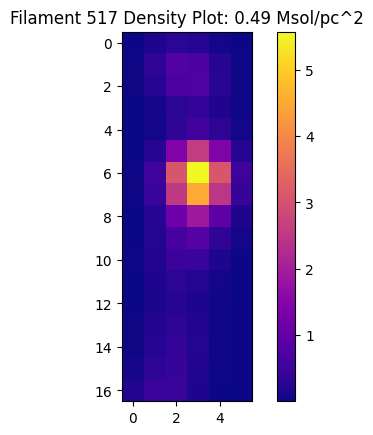

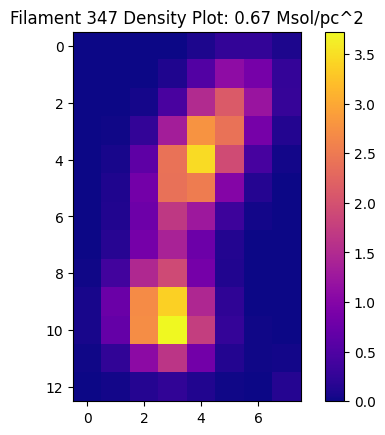

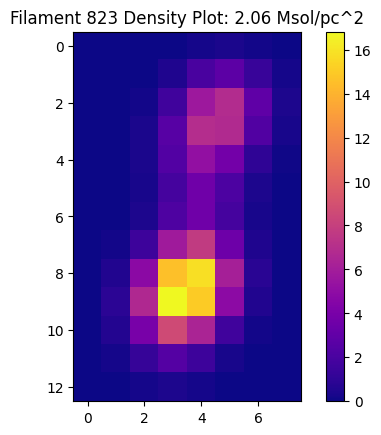

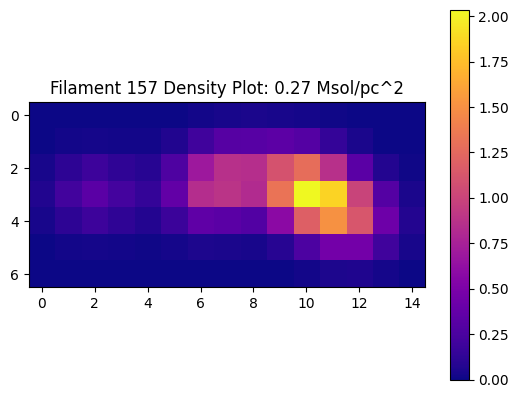

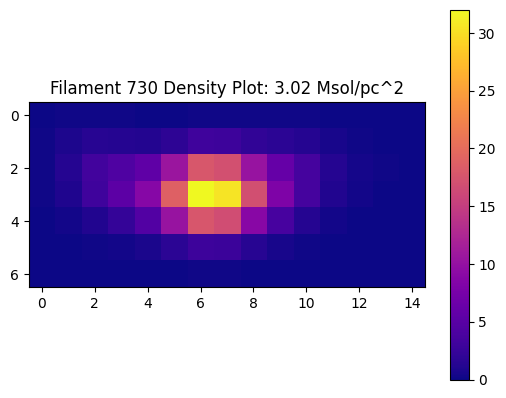

...

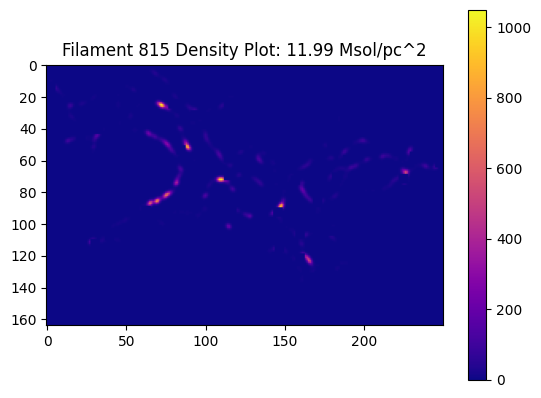

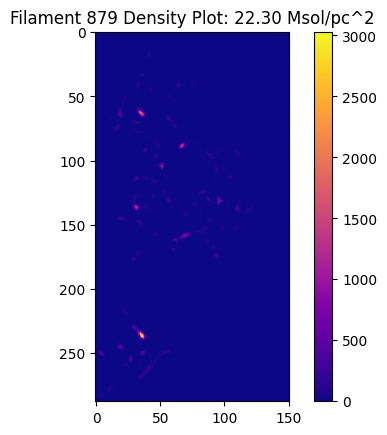

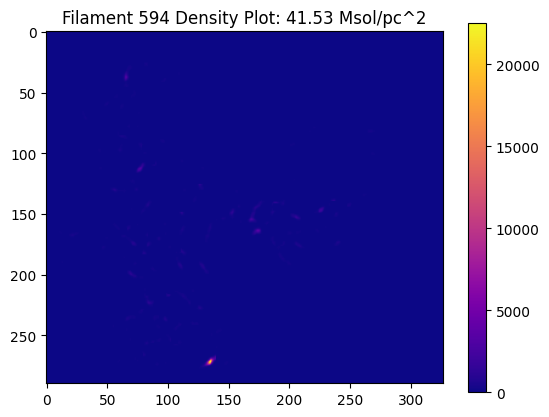

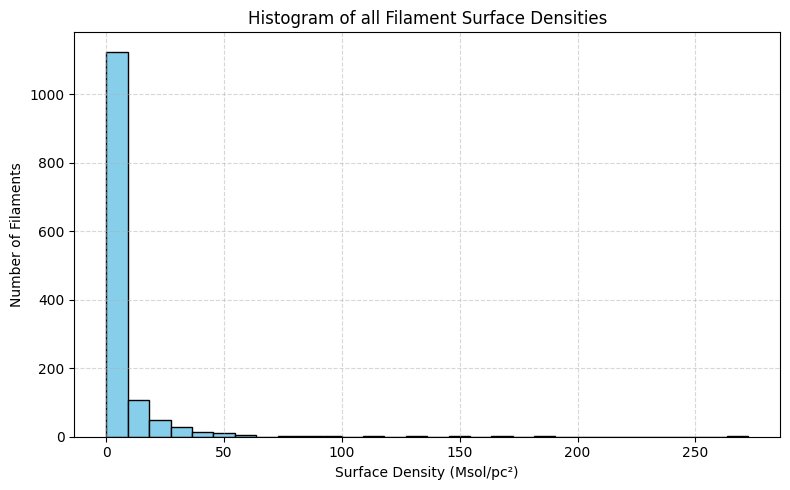

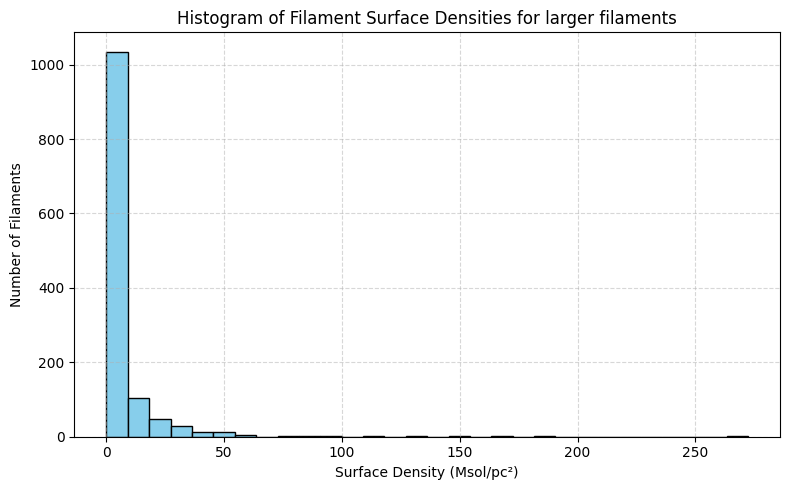

Average Surface Density (all filaments contribute equally): 6.49 Msol/pc^2
Surface Density Median: 1.97 Msol/pc^2
Surface Density Standard Deviation: 15.64 Msol/pc^2


In [153]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import AnalysisFuncs as AF

long_densities = []
Surface_Densities = []
num_pix = 100
mass_sum = 0

label_dict = {}
filament_bounds_dict = {}
fil_num = 0

# Extract all bounding boxes in the image
labels, stats, num_labels = AF.identify_connected_components(np.array(Molecular_Mass.astype(np.uint8)))

# Store label areas for sorting
for label_id in range(1, num_labels):
    width = stats[label_id, cv2.CC_STAT_WIDTH]
    height = stats[label_id, cv2.CC_STAT_HEIGHT]
    area = width * height
    label_dict[label_id] = area

# Sort bounding boxes by area (smallest to largest)
sorted_labels = sorted(label_dict.keys(), key=lambda k: label_dict[k])

# Keep track of a binary mask of previously counted regions
global_mask = np.zeros_like(Molecular_Mass, dtype=bool)

for label_id in sorted_labels:
    left = stats[label_id, cv2.CC_STAT_LEFT]
    top = stats[label_id, cv2.CC_STAT_TOP]
    width = stats[label_id, cv2.CC_STAT_WIDTH]
    height = stats[label_id, cv2.CC_STAT_HEIGHT]

    # Ensure bounding box is within image bounds
    y_end = min(top + height, Molecular_Mass.shape[0])
    x_end = min(left + width, Molecular_Mass.shape[1])

    # Extract region and create mask
    region = Molecular_Mass[top:y_end, left:x_end].copy()
    region_mask = region > 0

    # Zero out any pixels already counted in other filaments
    mask_slice = global_mask[top:y_end, left:x_end]
    region[mask_slice] = 0
    region_mask[mask_slice] = 0

    # Skip if nothing is left
    if not np.any(region_mask):
        continue

    # Store the new mask into the global mask to avoid double-counting
    global_mask[top:y_end, left:x_end] |= region_mask

    # Store bounding box for reference
    filament_bounds_dict[fil_num] = (left, top, x_end, y_end)

    Total_Mass = np.sum(region)
    mass_sum += Total_Mass
    filament_area = pc_pix**2 * np.count_nonzero(region)
    average_density = Total_Mass / filament_area
    Surface_Densities.append(average_density)
    fil_num += 1

    if filament_area > 5.24**2 * num_pix:
        plt.imshow(region * (1 / (5.24**2)), cmap='plasma')
        plt.colorbar()
        plt.title(f"Filament {label_id} Density Plot: {average_density:.2f} Msol/pc^2")
        plt.show()
        long_densities.append(average_density)

    if label_id == 962: 
        save_path =  "/Users/jakehoffmann/Documents/JHU_Research/FilPHANGS_Main/ngc0628_filament962_check.fits"
        # Save the model as a FITS file
        hdu = fits.PrimaryHDU(region*(1/5.24**2), header =header)
        hdu.writeto(save_path, overwrite=True)




# print(f'mass_sum: {mass_sum:.2E}')
# print(f"Total Mass: {np.sum(Molecular_Mass):.2E} Msol")
# Plot a histogram of surface densities
plt.figure(figsize=(8, 5))
plt.hist(Surface_Densities, bins=30, color='skyblue', edgecolor='black')
plt.title("Histogram of all Filament Surface Densities")
plt.xlabel("Surface Density (Msol/pc²)")
plt.ylabel("Number of Filaments")
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

plt.figure(figsize=(8, 5))
plt.hist(long_densities, bins=30, color='skyblue', edgecolor='black')
plt.title("Histogram of Filament Surface Densities for larger filaments")
plt.xlabel("Surface Density (Msol/pc²)")
plt.ylabel("Number of Filaments")
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

print(f"Average Surface Density (all filaments contribute equally): {np.mean(Surface_Densities):.2f} Msol/pc^2")
print(f"Surface Density Median: {np.median(Surface_Densities):.2f} Msol/pc^2")
print(f"Surface Density Standard Deviation: {np.std(Surface_Densities):.2f} Msol/pc^2")